In [ ]:
import pandas as pd
import re
import string
import nltk
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split

nltk.download('stopwords')

dataset = pd.read_csv("Datasets/Main_Dataset_Kaggle.csv")

# Splitting the dataset
train_data, temp_data = train_test_split(dataset, test_size=0.2, random_state=42)
valid_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)

train_data.to_csv('Datasets/train_data.csv', index=False)
valid_data.to_csv('Datasets/valid_data.csv', index=False)
test_data.to_csv('Datasets/test_data.csv', index=False)

# Function to remove punctuation
def remove_punctuation(text):
    return text.translate(str.maketrans('', '', string.punctuation))

def rmStopWords(text, langauge):
    if langauge in stopwords.fileids():
        stop_words = set(stopwords.words(langauge))
        words = text.split()
        filered_words =  [word for word in words if word not in stop_words]
        return ' '.join(filered_words)
    else:
        return text

# Function to remove HTML tags
def remove_html_tags(text):
    return re.sub(r'<.*?>', '', text)

def clean_and_tokenize(data):
    # Applying text cleaning steps
    data['Cleaned_Text'] = data['Text'].apply(remove_punctuation)
    data['Cleaned_Text'] = data['Cleaned_Text'].str.lower()
    data['Cleaned_Text'] = data['Cleaned_Text'].apply(lambda x: ' '.join(x.split()))
    
    # Assuming the language labels in your dataset are compatible with the language codes expected by nltk
    data['Cleaned_Text'] = data.apply(lambda row: rmStopWords(row['Cleaned_Text'], row['Language'].lower()), axis=1)
    
    data['Cleaned_Text'] = data['Cleaned_Text'].apply(remove_html_tags)
    
    # Character-level tokenization
    data['Char_Tokenized_Text'] = data['Cleaned_Text'].apply(list)
    
    return data

# Applying cleaning and tokenization to the split datasets
train_data = clean_and_tokenize(train_data)
valid_data = clean_and_tokenize(valid_data)
test_data = clean_and_tokenize(test_data)

# train_data.to_csv('Datasets/cleaned_and_tokenized_train_data.csv', index=False)
# valid_data.to_csv('Datasets/cleaned_and_tokenized_valid_data.csv', index=False)
# test_data.to_csv('Datasets/cleaned_and_tokenized_test_data.csv', index=False)

# Display the character tokenized text and language for training data
for index, row in train_data.iterrows():
    print(f"Character Tokenized Text: {row['Char_Tokenized_Text']}")
    print(f"Language: {row['Language']}")
    print('-' * 40)  # Print a separator line


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/ramzidaher/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Character Tokenized Text: ['ส', 'ั', 'ม', 'ป', 'ร', 'ะ', 'ส', 'ิ', 'ท', 'ธ', 'ิ', '์', 'ฮ', 'อ', 'ล', 'ล', '์', ' ', 'ฟ', 'ิ', 'ส', 'ิ', 'ก', 'ส', '์', 'ไ', 'ฟ', 'ฟ', '้', 'า', ' ', 'เ', 'ก', 'ี', '่', 'ย', 'ว', 'ก', 'ั', 'บ', 'ส', 'น', 'า', 'ม', 'แ', 'ม', '่', 'เ', 'ห', 'ล', '็', 'ก', 'ท', 'ี', '่', 'ใ', 'ห', '้', 'ก', 'ั', 'บ', 'ว', 'ั', 'ต', 'ถ', 'ุ', ' ', 'เ', 'ท', 'ี', 'ย', 'บ', 'ก', 'ั', 'บ', 'ค', 'ว', 'า', 'ม', 'ต', '่', 'า', 'ง', 'ศ', 'ั', 'ก', 'ย', '์', 'ท', 'ี', '่', 'ส', 'ร', '้', 'า', 'ง', 'ข', 'ึ', '้', 'น', ' ', 'ป', 'ร', 'ิ', 'ม', 'า', 'ณ', 'ข', 'อ', 'ง', 'ก', 'ร', 'ะ', 'แ', 'ส', 'ไ', 'ฟ', 'ฟ', '้', 'า', ' ', 'แ', 'ล', 'ะ', 'ค', 'ว', 'า', 'ม', 'ห', 'น', 'า', 'ข', 'อ', 'ง', 'ว', 'ั', 'ต', 'ถ', 'ุ', ' ', 'เ', 'ป', '็', 'น', 'ล', 'ั', 'ก', 'ษ', 'ณ', 'ะ', 'เ', 'ฉ', 'พ', 'า', 'ะ', 'ข', 'อ', 'ง', 'ว', 'ั', 'ส', 'ด', 'ุ', 'ท', 'ี', '่', 'น', 'ำ', 'ม', 'า', 'ใ', 'ช', '้', 'ท', 'ำ', 'ต', 'ั', 'ว', 'น', 'ำ', 'ไ', 'ฟ', 'ฟ', '้', 'า']
Language: Thai
---------------------------------

In [ ]:
# Using pandas for descriptive statistics
print(train_data.describe(include='all'))  # include='all' will also show statistics for non-numeric columns


                                                     Text Language  \
count                                               17600    17600   
unique                                              17497       22   
top     haec commentatio automatice praeparata res ast...  Swedish   
freq                                                   38      821   

                                             Cleaned_Text  \
count                                               17600   
unique                                              17491   
top     haec commentatio automatice praeparata res ast...   
freq                                                   38   

                                      Char_Tokenized_Text  
count                                               17600  
unique                                              17491  
top     [h, a, e, c,  , c, o, m, m, e, n, t, a, t, i, ...  
freq                                                   38  


In [ ]:
train_data['Text_Length'] = train_data['Cleaned_Text'].apply(len)
print(train_data['Text_Length'].describe())


count    17600.000000
mean       319.483352
std        219.278583
min          0.000000
25%        170.000000
50%        247.000000
75%        392.000000
max       1341.000000
Name: Text_Length, dtype: float64


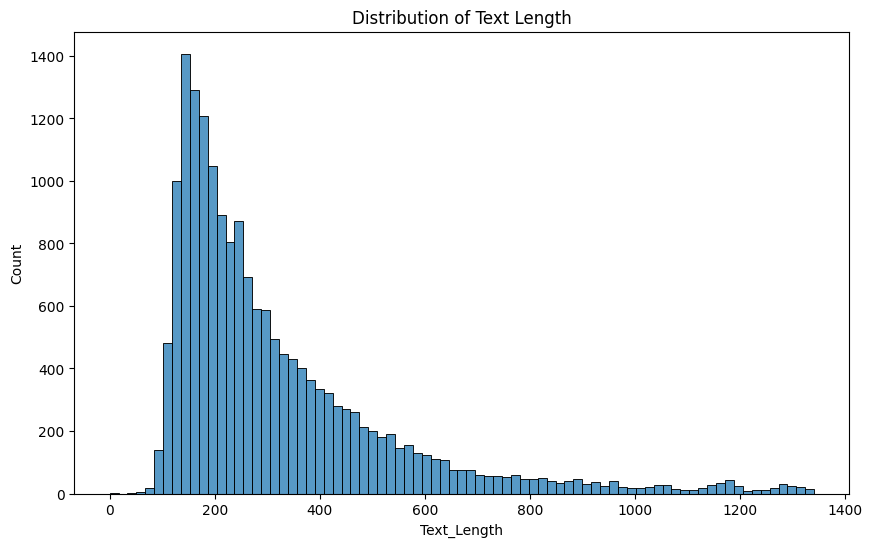

ValueError: Could not interpret value `Label` for `x`. An entry with this name does not appear in `data`.

<Figure size 1000x600 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram of text length
plt.figure(figsize=(10,6))
sns.histplot(train_data['Text_Length'])
plt.title('Distribution of Text Length')
plt.show()

if 'Label' in train_data:
    plt.figure(figsize=(10,6))
    sns.boxplot(x='Label', y='Text_Length', data=train_data)
    plt.title('Text Length by Label')
    plt.show()


In [ ]:
import numpy as np  # Import NumPy
from collections import Counternin
from sklearn.feature_extraction.text import CountVectorizer

# Your existing code for vectorization and word frequency calculation
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(train_data['Cleaned_Text'])
word_freq = dict(zip(vectorizer.get_feature_names_out(), np.asarray(X.sum(axis=0)).ravel()))
word_counter = Counter(word_freq)
common_words = word_counter.most_common(10)

# Writing common words to a text file
with open('common_words.txt', 'w') as file:
    for word, freq in common_words:
        file.write(f"{word}: {freq}\n")

# Now you have a text file named 'common_words.txt' with all the common words and their frequencies


In [ ]:
vectorizer_ngram = CountVectorizer(ngram_range=(2, 2))  # bigram analysis
X_ngram = vectorizer_ngram.fit_transform(train_data['Cleaned_Text'])
ngram_freq = dict(zip(vectorizer_ngram.get_feature_names_out(), np.asarray(X_ngram.sum(axis=0)).ravel()))
ngram_counter = Counter(ngram_freq)
common_ngrams = ngram_counter.most_common(10)
print(common_ngrams)


[('கப பட', 320), ('mm nederbörd', 274), ('است که', 252), ('در سال', 236), ('می شود', 228), ('ہے اور', 225), ('که در', 214), ('چې په', 194), ('شده است', 179), ('of the', 176)]


In [ ]:
print(train_data.isnull().sum())


Text                   0
Language               0
Cleaned_Text           0
Char_Tokenized_Text    0
Text_Length            0
dtype: int64
